<a href="https://colab.research.google.com/github/Jeremie-Gabor97/fastai-notebooks/blob/master/Jeremie_SportsClassification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
!curl -s https://course.fast.ai/setup/colab 1 | bash
!pip uninstall torch torchvision -y
!pip install torch==1.4.0 torchvision==0.5.0

Updating fastai...
Done.
Uninstalling torch-1.5.0+cu101:
  Successfully uninstalled torch-1.5.0+cu101
Uninstalling torchvision-0.6.0+cu101:
  Successfully uninstalled torchvision-0.6.0+cu101
     |████████████████████████████████| 753.4MB 21kB/s 
     |████████████████████████████████| 4.0MB 39.5MB/s 


In [0]:
# check version
!pip show torch
!pip show torchvision
!pip show fastai

Name: torch
Version: 1.4.0
Summary: Tensors and Dynamic neural networks in Python with strong GPU acceleration
Home-page: https://pytorch.org/
Author: PyTorch Team
Author-email: packages@pytorch.org
License: BSD-3
Location: /usr/local/lib/python3.6/dist-packages
Requires: 
Required-by: torchvision, torchtext, fastai
Name: torchvision
Version: 0.5.0
Summary: image and video datasets and models for torch deep learning
Home-page: https://github.com/pytorch/vision
Author: PyTorch Core Team
Author-email: soumith@pytorch.org
License: BSD
Location: /usr/local/lib/python3.6/dist-packages
Requires: six, numpy, pillow, torch
Required-by: fastai
Name: fastai
Version: 1.0.61
Summary: fastai makes deep learning with PyTorch faster, more accurate, and easier
Home-page: https://github.com/fastai/fastai
Author: Jeremy Howard
Author-email: info@fast.ai
License: Apache Software License 2.0
Location: /usr/local/lib/python3.6/dist-packages
Requires: fastprogress, numpy, requests, dataclasses, packaging, p

I am going to use the event dataset by Li-Jia Li and Li Fei-Fei. What, where and who? Classifying event by scene and object recognition . IEEE Intern. Conf. in Computer Vision (ICCV). 2007.
The dataset containes images for 8 sports event categories, each separated into its own folder. The images also contain information about the difficultly of human subject judgment as well as distance of foreground objects, however these are not used in my experiment.

http://vision.stanford.edu/lijiali/event_dataset/


In [0]:
# magic commands
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [0]:
from fastai.vision import * 
from fastai.metrics import error_rate

In [0]:
from google.colab import drive
drive.mount('/content/gdrive',force_remount=True)
root_dir = "gdrive/My Drive/"
base_dir = root_dir + "Online Courses & Learning/fastai/event_dataset/event_img"

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
# Read in data
tfms = get_transforms()
data = (ImageList.from_folder(base_dir)
        .split_by_rand_pct()
        .label_from_folder()
        .transform(tfms, size=224)
        .databunch())

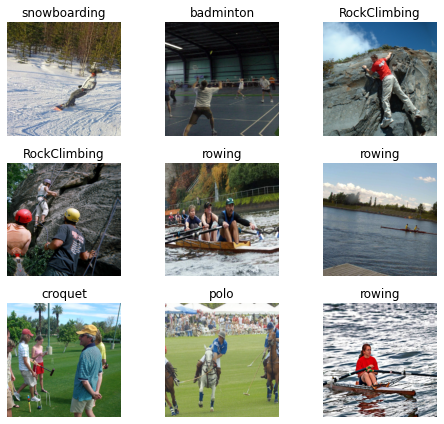

In [0]:
# visualize data, note that I used folder names to label data
data.show_batch(rows=3, figsize=(7,6))

In [0]:
# these are all the classes, 8 of them in total
print(data.classes)
len(data.classes),data.c

['RockClimbing', 'badminton', 'bocce', 'croquet', 'polo', 'rowing', 'sailing', 'snowboarding']


(8, 8)

cnn_learner function creates a learner object from the e data object and model inferred from it with the backbone  given as the second argument.
Basically, it helps you automatically get a pretrained model from a given architecture with a custome head that is suitable for your data.

The idea is to keep all the convolutional layers (called the backbone or body of the model) with their weights pretrained but then we define a new head initialized randomly. Then we typically follow two steps:
1. Freeze the body weights and train the head
2. Unfreeze the layers of the body gradually and fine tune the whole model (possibly using differential learning rates)

In [0]:
learn = cnn_learner(data, models.resnet34, metrics=error_rate)

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/checkpoints/resnet34-333f7ec4.pth


In [0]:
learn.fit_one_cycle(4)

epoch,train_loss,valid_loss,error_rate,time
0,1.546132,0.211450,0.066667,07:28
1,0.748358,0.107147,0.034921,01:29
2,0.457949,0.090828,0.028571,01:23
3,0.323006,0.092774,0.028571,01:22


4% error rate! 

In [0]:
learn.save('stage-1')

In [0]:
learn.load('stage-1')

Learner(data=ImageDataBunch;

Train: LabelList (1264 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
sailing,sailing,sailing,sailing,sailing
Path: gdrive/My Drive/Online Courses & Learning/fastai/event_dataset/event_img;

Valid: LabelList (315 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
RockClimbing,croquet,rowing,croquet,RockClimbing
Path: gdrive/My Drive/Online Courses & Learning/fastai/event_dataset/event_img;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2

In general, training with higher learning rates helps in reducing the training time but also improves the model performance (model generalizes, instead of memorizing data). However, using a large learning rate can cause training to diverge and using lower learning rates can cause overfitting to occur. The solution is to find the optimal learning rate for your data.

Motivation for using Cyclical learning rate: Higher learning rates help come out of saddle points and lower learning rates prevent training from diverging.
Read this: https://arxiv.org/pdf/1506.01186.pdf

In [0]:
# provides a confusion matrix and visualization of the most incorrect images
interp = ClassificationInterpretation.from_learner(learn)
losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

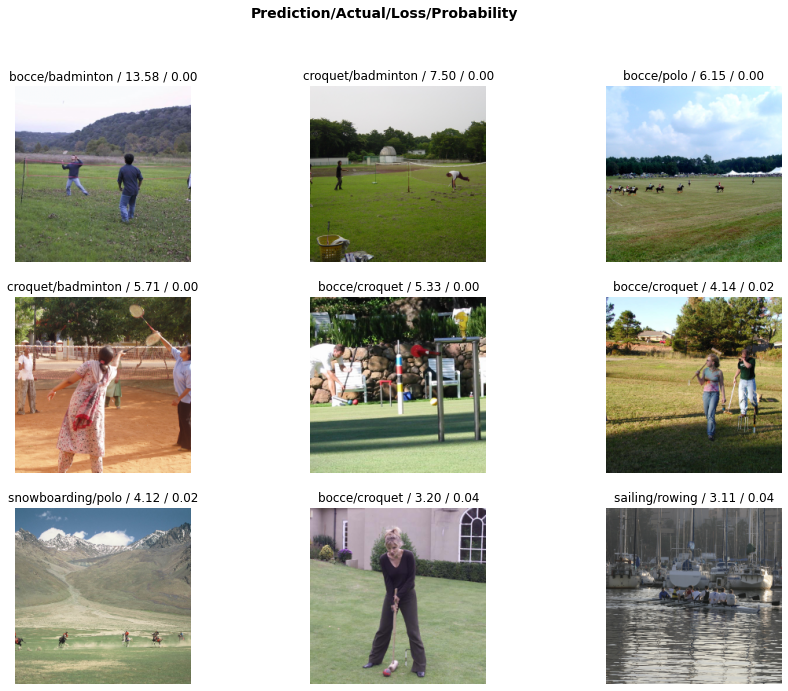

In [0]:
# shows images with highest loss.
interp.plot_top_losses(9, figsize=(15,11))

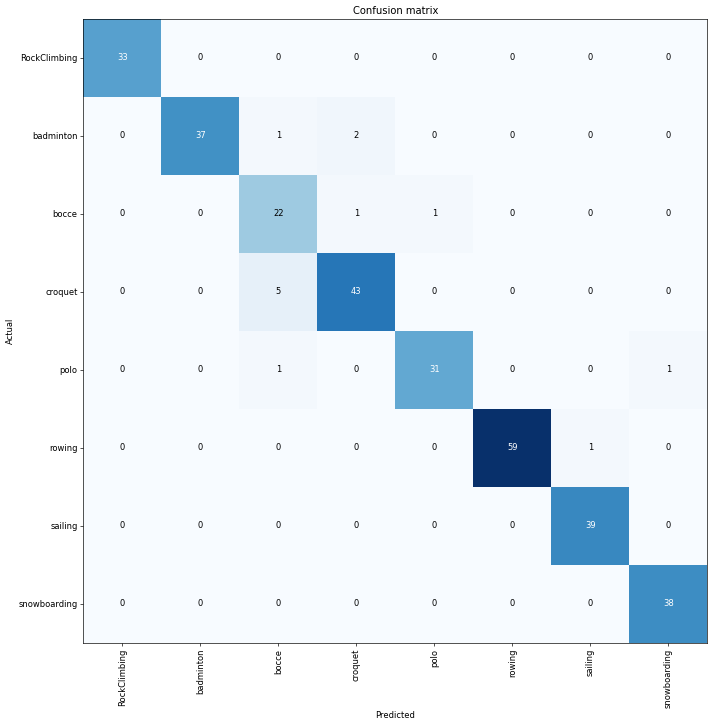

In [0]:
interp.plot_confusion_matrix(figsize=(12,12), dpi=60)
# outside of the main diagonal, we see that bocce is often confused for croquet (5 times)

In [0]:
interp.most_confused(min_val=2)

[('croquet', 'bocce', 5), ('badminton', 'croquet', 2)]

In [0]:
# We can try to unfreeze model and make it even better...
learn.unfreeze()

In [0]:
learn.fit_one_cycle(1)

epoch,train_loss,valid_loss,error_rate,time
0,0.252106,0.326791,0.073016,01:19


In [0]:
# if the model performance becomes worst, we can reload the previous version of the model we had
# Our loss was already pretty low and went up to 7%, so lets load back the old weights
learn.load('stage-1');

In [0]:
learn.lr_find()
# explore learning rate from start lr to end lr (using defaults here). stops when loss diverges
# Runs the learning rate finder defined in LRFinder

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


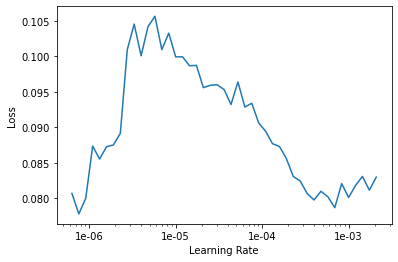

In [0]:
# this is a bit of weird shape, usually the y-axis extends to high loss values,
#  maybe 0.4 or 0.5. But we can still see that the lowest learning rate is
#  achieved at 1e-03, so we start our cycle learning rate about 1 or 2
#  orders of magnitude before that
learn.recorder.plot()

In [0]:
learn.unfreeze()
learn.fit_one_cycle(2, max_lr=slice(1e-5,1e-3))

epoch,train_loss,valid_loss,error_rate,time
0,0.078548,0.181831,0.031746,01:20
1,0.073117,0.179464,0.025397,01:16


That's quite a low error rate!


I figured I'd give this a try on a few of my own images as well as some found online!

In [0]:
learn.save('stage-2')

In [0]:
learn.load('stage-2')

Learner(data=ImageDataBunch;

Train: LabelList (1264 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
sailing,sailing,sailing,sailing,sailing
Path: gdrive/My Drive/Online Courses & Learning/fastai/event_dataset/event_img;

Valid: LabelList (315 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
polo,sailing,polo,snowboarding,croquet
Path: gdrive/My Drive/Online Courses & Learning/fastai/event_dataset/event_img;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, 

In [0]:
learn.data.classes

['RockClimbing',
 'badminton',
 'bocce',
 'croquet',
 'polo',
 'rowing',
 'sailing',
 'snowboarding']

In [0]:
# export the content of learner object
learn.export()
# should have 'export.pkl' file in directory

In [0]:
# most of the time I'd want to use CPU for inference, expcept at massive scale.
# One a CPU is better at doing multiple things at the same time (think multiple users)
# It might not be as fast but users are only gonna be requesting classification 
# of single images (most of the time) so you cant really take advantage of the
# vectorization magic of GPUs
defaults.device = torch.device('cpu')

In [0]:
learn = load_learner(base_dir)

In [0]:
print(root_dir)
print(base_dir)

gdrive/My Drive/
gdrive/My Drive/Online Courses & Learning/fastai/event_dataset/event_img


In [0]:
image_dir = root_dir + "Online Courses & Learning/fastai/my_images"
# image_dir = base_dir + '/' + "RockClimbing"
image_name = 'my_rockClimbing_1.jpg'
# image_name = "Easy_Mid_RockClimbing_7.jpg"
print(image_dir)
print(image_name)

gdrive/My Drive/Online Courses & Learning/fastai/my_images
my_rockClimbing_1.jpg


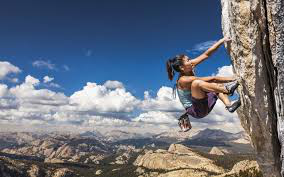

In [0]:
img = open_image(image_dir + '/' + image_name)
img

In [0]:
pred_class,pred_idx,outputs = learn.predict(img)
print(pred_class)
print(outputs)
# interstingly this one doesn't get sorted properly
# Should consider adding more images to the training set

croquet
tensor([1.0070e-01, 6.7363e-04, 4.0103e-04, 8.6254e-01, 1.2672e-04, 1.2675e-03,
        3.9951e-03, 3.0299e-02])


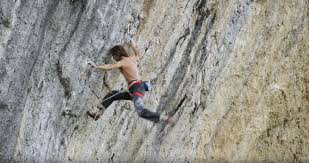

In [0]:
image_name = 'my_rockClimbing_2.jpg'
img = open_image(image_dir + '/' + image_name)
img

In [0]:
pred_class,pred_idx,outputs = learn.predict(img)
print(pred_class)
print(outputs)

RockClimbing
tensor([1.0000e+00, 1.5736e-07, 2.1249e-07, 1.5967e-07, 1.4375e-08, 2.1741e-06,
        8.7138e-09, 3.3149e-07])


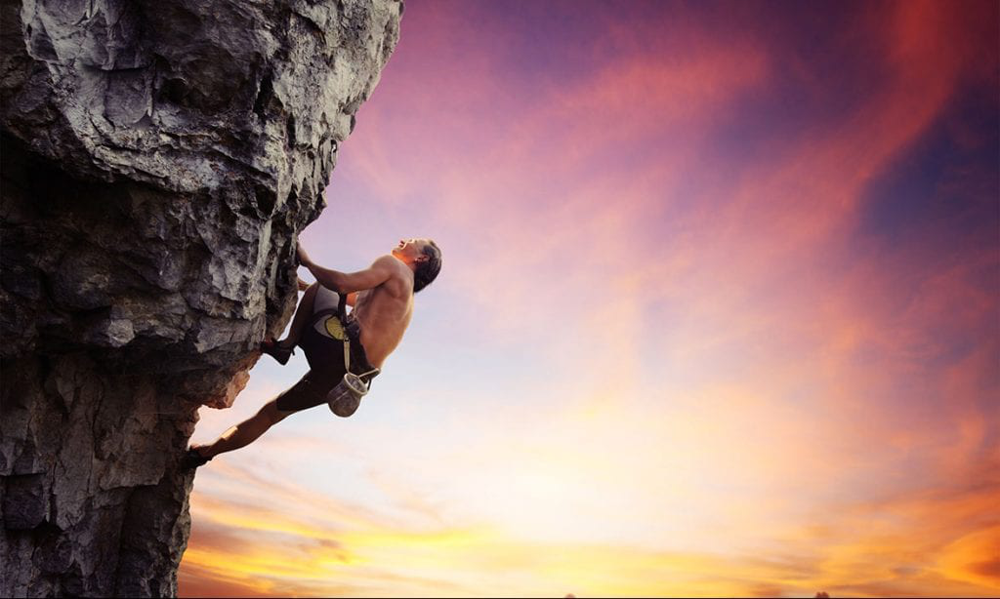

In [0]:
image_name = 'my_rockClimbing_3.jpg'
img = open_image(image_dir + '/' + image_name)
img

In [0]:
pred_class,pred_idx,outputs = learn.predict(img)
print(pred_class)
print(outputs)

RockClimbing
tensor([9.9732e-01, 3.0130e-06, 2.0558e-07, 4.3780e-06, 1.7047e-03, 4.5387e-07,
        1.5260e-05, 9.4936e-04])


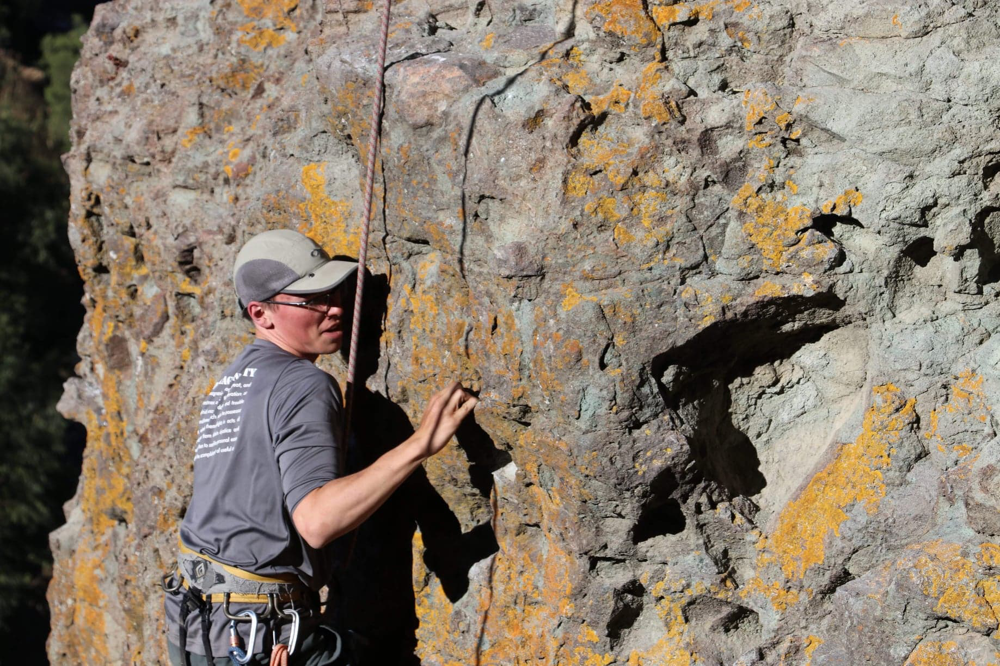

In [0]:
image_name = 'my_rockClimbing_4.jpg'
img = open_image(image_dir + '/' + image_name)
img

In [0]:
pred_class,pred_idx,outputs = learn.predict(img)
print(pred_class)
print(outputs)

RockClimbing
tensor([1.0000e+00, 9.7853e-08, 1.2531e-06, 6.4625e-08, 1.2807e-07, 1.2025e-07,
        3.4554e-08, 9.9675e-09])


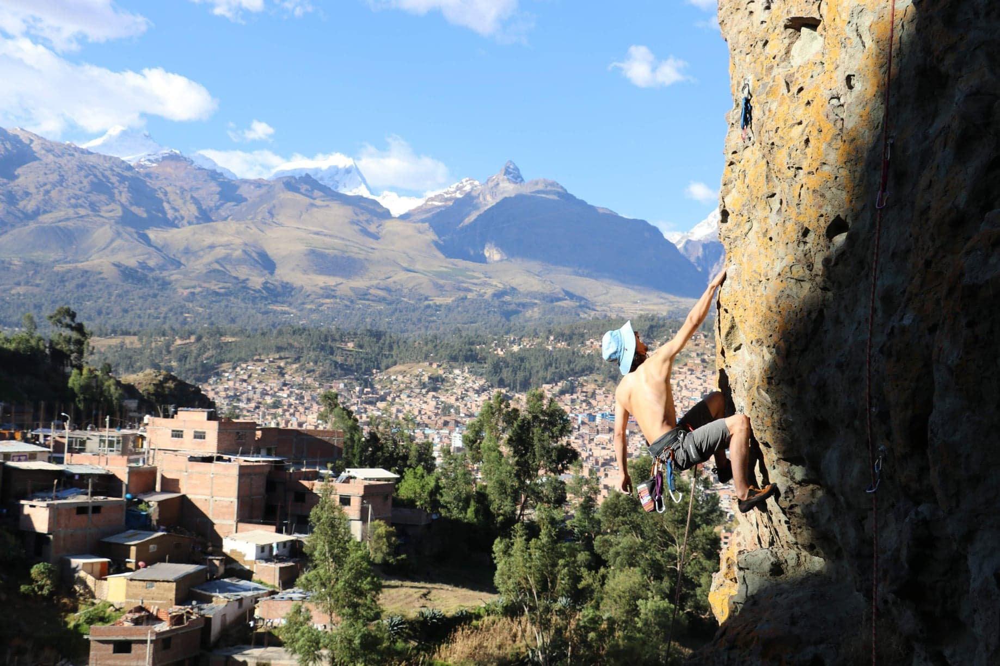

In [0]:
image_name = 'my_rockClimbing_5.jpg'
img = open_image(image_dir + '/' + image_name)
img

In [0]:
pred_class,pred_idx,outputs = learn.predict(img)
print(pred_class)
print(outputs)

RockClimbing
tensor([9.9582e-01, 4.5639e-08, 4.1572e-03, 2.2882e-06, 5.8465e-06, 1.0108e-05,
        9.8318e-07, 7.6270e-07])


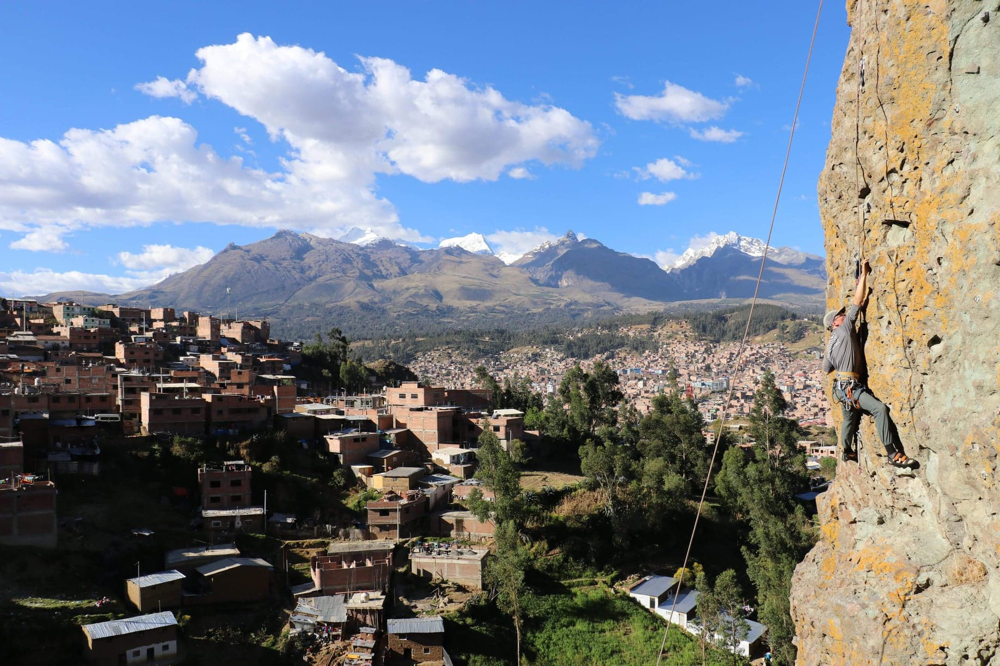

In [0]:
image_name = 'my_rockClimbing_6.jpg'
img = open_image(image_dir + '/' + image_name)
img

In [0]:
pred_class,pred_idx,outputs = learn.predict(img)
print(pred_class)
print(outputs)

RockClimbing
tensor([0.5987, 0.0268, 0.2034, 0.0138, 0.0008, 0.0254, 0.0063, 0.1249])


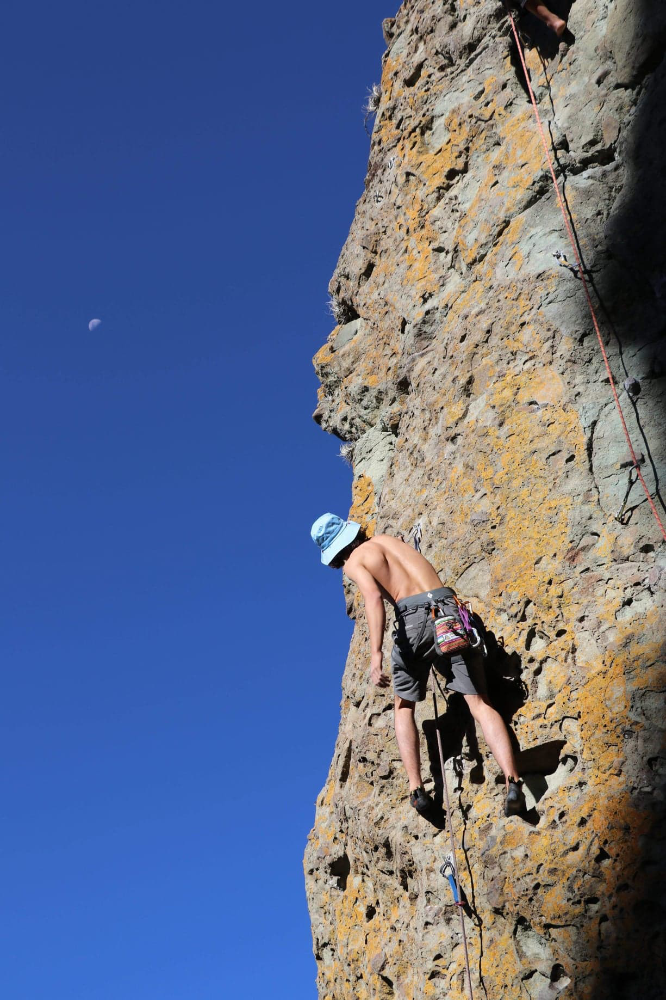

In [0]:
image_name = 'my_rockClimbing_7.jpg'
img = open_image(image_dir + '/' + image_name)
img

In [0]:
pred_class,pred_idx,outputs = learn.predict(img)
print(pred_class)
print(outputs)

RockClimbing
tensor([1.0000e+00, 2.7451e-09, 4.2331e-10, 1.1759e-09, 5.1010e-10, 4.4272e-08,
        1.0599e-10, 7.0224e-10])


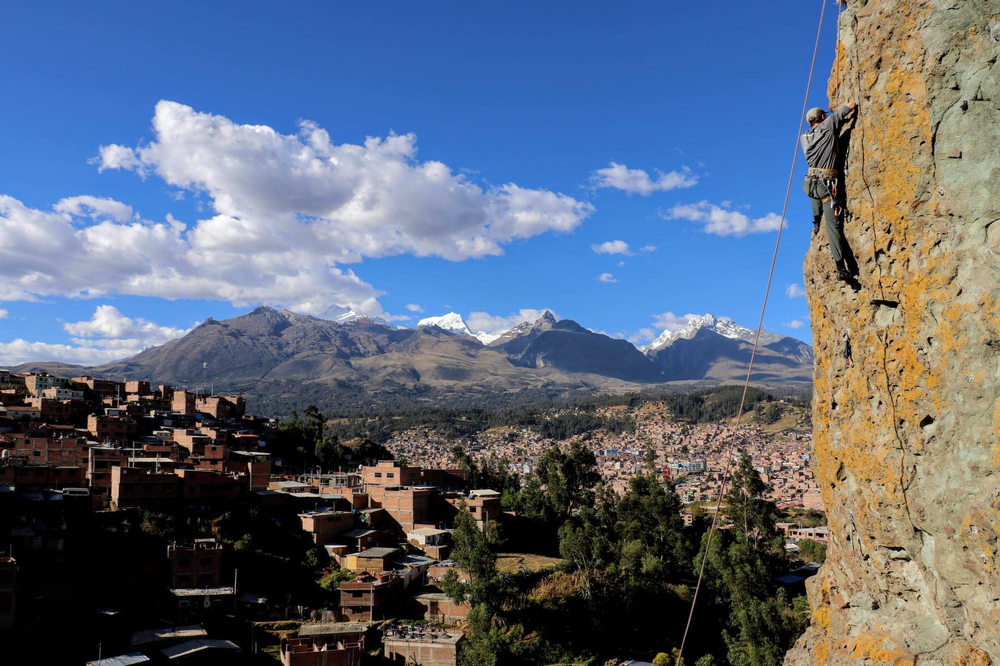

In [0]:
image_name = 'my_rockClimbing_8.jpg'
img = open_image(image_dir + '/' + image_name)
img

In [0]:
pred_class,pred_idx,outputs = learn.predict(img)
print(pred_class)
print(outputs)

snowboarding
tensor([7.9538e-02, 8.0993e-04, 1.0281e-01, 2.2163e-01, 4.7271e-04, 8.0820e-03,
        4.7172e-03, 5.8194e-01])


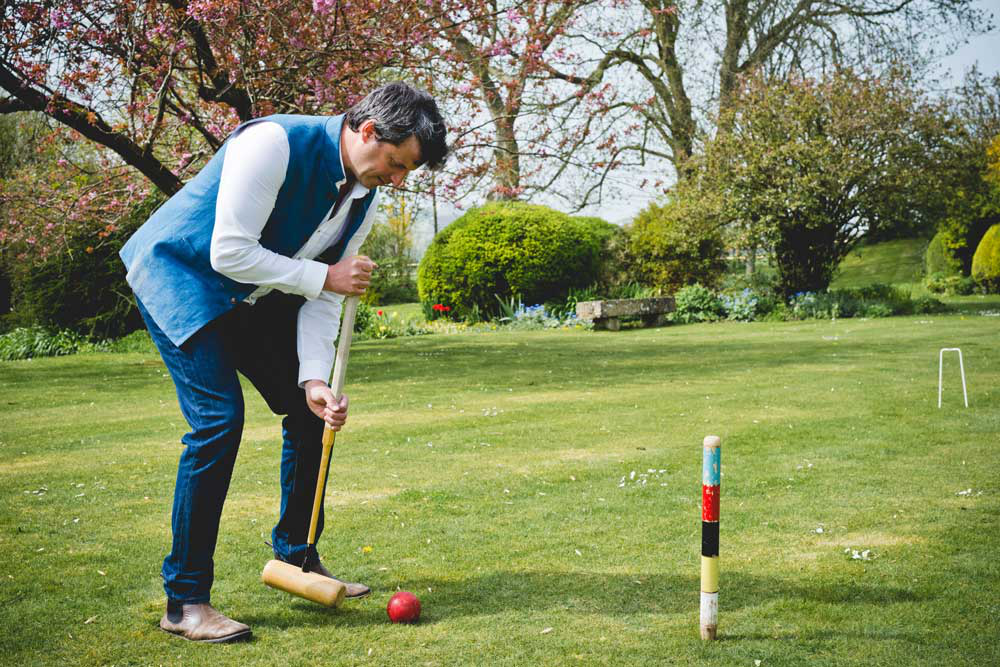

In [0]:
image_name = 'my_croquet_1.jpg'
img = open_image(image_dir + '/' + image_name)
img

In [0]:
pred_class,pred_idx,outputs = learn.predict(img)
print(pred_class)
print(outputs)

croquet
tensor([4.7144e-11, 4.6989e-11, 7.6704e-08, 1.0000e+00, 1.6101e-11, 1.8409e-12,
        3.5462e-10, 2.7997e-12])
